# Siren Case Study: Beginning
---
## Searching Rigth values for target model's hyper-params

## Notebook Options
---

In [1]:
INSTALL_THIRD_PARTY_LIBS = True #@param {type:"boolean"}
RUN_COLAB_CODE = True #@param {type:"boolean"}
VIEW_IMAGE = True #@param {type:"boolean"}

In [2]:
SIDELENGTH = 256 #@param {type:"integer"}

## Setup Notebook
---

### Imports

In [3]:
# Installing third party dependencies
if INSTALL_THIRD_PARTY_LIBS:
    print("Installing required libraries...")

    old_requirements = '/content/tmp_requirements.txt'
    !pip freeze > {old_requirements}
    dependencies_list = "stats,pretrainedmodels,torchnet,xlsxwriter,gitpython,python-git,cmapy,sk-video,pytorch-model-summary,ConfigArgParse,tabulate,chart_studio,dash,dash_bootstrap_components".split(",")

    with open(old_requirements) as f:
        old_requirements_list = f.read().split("\n")
        for a_req in dependencies_list:
            found_req = False
            for old_req in old_requirements_list:
                if old_req.startswith(a_req):
                    print(f"{a_req} already installed!")
                    found_req = True
                    break
            if found_req is False:
                !pip install {a_req} -q
        pass
    !rm -f {old_requirements}
    pass

Installing required libraries...
stats already installed!
     |████████████████████████████████| 61kB 6.0MB/s 
     |████████████████████████████████| 686kB 10.4MB/s 
     |████████████████████████████████| 204kB 16.9MB/s 
     |████████████████████████████████| 153kB 11.8MB/s 
     |████████████████████████████████| 163kB 12.1MB/s 
     |████████████████████████████████| 71kB 7.5MB/s 
     |████████████████████████████████| 2.3MB 12.7MB/s 
     |████████████████████████████████| 51kB 5.6MB/s 
tabulate already installed!
     |████████████████████████████████| 71kB 7.0MB/s 
     |████████████████████████████████| 81kB 6.1MB/s 
     |████████████████████████████████| 1.0MB 17.3MB/s 
     |████████████████████████████████| 3.5MB 46.9MB/s 
     |████████████████████████████████| 194kB 48.3MB/s 
     |████████████████████████████████| 1.8MB 45.7MB/s 
     |████████████████████████████████| 358kB 44.2MB/s 
     |████████████████████████████████| 194kB 12.9MB/s 


In [4]:
%matplotlib inline
from __future__ import print_function
from __future__ import division

if RUN_COLAB_CODE:


    # --------------------------------------------- #
    # Standard Library, plus some Third Party Libraries
    # --------------------------------------------- #

    DASH_TEMPLATES_LIST = ["plotly", "plotly_white", "plotly_dark", "ggplot2", "seaborn", "simple_white", "none"]

    from PIL import Image
    from functools import partial
    from pprint import pprint
    from tqdm import tqdm
    from typing import Tuple, Union


    import configargparse
    import copy
    import collections
    import cProfile
    import datetime
    import functools
    import itertools
    import h5py
    import logging
    import math
    import os
    import operator
    import pickle
    import random
    import shutil
    import sys
    import re
    import tabulate 
    import time
    # import visdom


    from collections import OrderedDict
    import matplotlib
    import matplotlib.pyplot as plt
    import numpy as np

    # --------------------------------------------- #
    # Data Science and Machine Learning Libraries
    # --------------------------------------------- #
    import matplotlib
    import matplotlib.pyplot as plt
    matplotlib.style.use('ggplot')
    import seaborn as sns

    import numpy as np
    import pandas as pd
    import sklearn

    from sklearn.model_selection import ParameterGrid
    from sklearn.model_selection import train_test_split

    # --------------------------------------------- #
    # Torch
    # --------------------------------------------- #
    import torch
    try:
        import torch
        import torch.nn as nn
        import torch.nn.functional as F
        import torch.optim as optim
        from torch.utils.data import DataLoader, Dataset
        # import torch.quantization
        # import torch.nn.utils.prune as prune

        from torch import nn, optim

    except Exception as err:
        print(err)
        print("torch not available!")
        pass

    from numpy import linalg as LA
    from scipy.stats import rankdata
    from collections import OrderedDict
    from torchvision import datasets, transforms
    from torch.utils.data.sampler import SubsetRandomSampler

    # --------------------------------------------- #
    # Import: torch_pruning
    # --------------------------------------------- #
    # import torch_pruning as tp


    # --------------------------------------------- #
    # Import: TorchVision
    # --------------------------------------------- #
    try:
        import torchvision
        from torchvision import datasets
        from torchvision import transforms
        from torchvision.transforms import Resize, Compose, ToTensor, CenterCrop, Normalize
        from torchvision.utils import save_image
    except:
        print("torchvision library not available!")
        pass

    # Plotly imports.
    # ----------------------------------------------- #
    import chart_studio.plotly as py
    import plotly.figure_factory as ff
    import plotly.express as px

    # --------------------------------------------- #
    # Import: skimage
    # --------------------------------------------- #
    try:
        import skimage
        import skimage.metrics as skmetrics
        from skimage.metrics import peak_signal_noise_ratio as psnr
        from skimage.metrics import structural_similarity as ssim
        from skimage.metrics import mean_squared_error
    except:
        print("skimage library not available!")
        pass

### PyTorch Architectures

In [5]:
if RUN_COLAB_CODE:
    class SineLayer(nn.Module):
        # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
        
        # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
        # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
        # hyperparameter.
        
        # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
        # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
        
        def __init__(self, in_features, out_features, bias=True,
                    is_first=False, omega_0=30):
            super().__init__()
            self.omega_0 = omega_0
            self.is_first = is_first
            
            self.in_features = in_features
            self.linear = nn.Linear(in_features, out_features, bias=bias)
            
            self.init_weights()
            pass
        
        def init_weights(self):
            with torch.no_grad():
                if self.is_first:
                    self.linear.weight.uniform_(-1 / self.in_features, 
                                                1 / self.in_features)      
                else:
                    self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                                np.sqrt(6 / self.in_features) / self.omega_0)
            pass
            
        def forward(self, input):
            return torch.sin(self.omega_0 * self.linear(input))
        
        def forward_with_intermediate(self, input): 
            # For visualization of activation distributions
            intermediate = self.omega_0 * self.linear(input)
            return torch.sin(intermediate), intermediate
        pass
        
        
    class Siren(nn.Module):
        def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False, 
                    first_omega_0=30, hidden_omega_0=30.):
            super().__init__()
            
            self.net = []
            self.net.append(SineLayer(in_features, hidden_features, 
                                    is_first=True, omega_0=first_omega_0))

            for i in range(hidden_layers):
                self.net.append(SineLayer(hidden_features, hidden_features, 
                                        is_first=False, omega_0=hidden_omega_0))

            if outermost_linear:
                final_linear = nn.Linear(hidden_features, out_features)
                
                with torch.no_grad():
                    final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                                np.sqrt(6 / hidden_features) / hidden_omega_0)
                    
                self.net.append(final_linear)
            else:
                self.net.append(SineLayer(hidden_features, out_features, 
                                        is_first=False, omega_0=hidden_omega_0))
            
            self.net = nn.Sequential(*self.net)
            pass
        
        def forward(self, coords):
            coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
            output = self.net(coords)
            return output, coords        

        def forward_with_activations(self, coords, retain_grad=False):
            '''Returns not only model output, but also intermediate activations.
            Only used for visualizing activations later!'''
            activations = OrderedDict()

            activation_count = 0
            x = coords.clone().detach().requires_grad_(True)
            activations['input'] = x
            for i, layer in enumerate(self.net):
                if isinstance(layer, SineLayer):
                    x, intermed = layer.forward_with_intermediate(x)
                    
                    if retain_grad:
                        x.retain_grad()
                        intermed.retain_grad()
                        
                    activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                    activation_count += 1
                else: 
                    x = layer(x)
                    
                    if retain_grad:
                        x.retain_grad()
                        
                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
                activation_count += 1

            return activations
        pass

### Functions

In [6]:
def calculate_several_jpeg_compression(image, image_dim_bits, qualities):
    from io import BytesIO
    # Named tuple for creating a record related to
    # a trial for compressing the target image.
    typename = 'WeightsPsnr'
    fields_name = ['mse', 'psnr', 'ssim', 'quality', 'file_size_bits', 'bpp', 'width', 'heigth', 'CR']
    WeightsPsnr = collections.namedtuple(typename, fields_name) 

    # List used to save results and keep trace of failures, if any.
    result_tuples = []
    failure_qualities = []

    # Then test the effect of several different quality values
    # used in compression transform.
    for quality in qualities:
        try:
            # Convert to JPEG specifying quality of compression.
            with BytesIO() as f:
                # im_tmp.save(f'myimg.jpg', quality = int(quality))
                # im_jpeg = Image.open('myimg.jpg')
                
                image.save(f, format='JPEG', quality = int(quality))
                f.seek(0)
                compressed_file_size_bits = f.getbuffer().nbytes * 8
                compressed_file_size_bits = image.tell() * 8
                im_jpeg = Image.open(f)
                assert im_jpeg.size == image.size, "im_jpeg.size != image.size"
    
                # Calculate quantities to be stored for this trial
            
                # data used for deriving scores
                width, height = im_jpeg.size[0], im_jpeg.size[1]
                pixels = width * height
                # compressed_file_size_bits = Path('myimg.jpg').stat().st_size * 8
                compressed_file_size_bits = f.getbuffer().nbytes * 8
            
                # Scores
                bpp = compressed_file_size_bits / pixels
                mse_score = mean_squared_error(np.asarray(image), np.asarray(im_jpeg))
                psnr_score = psnr(np.asarray(image), np.asarray(im_jpeg), data_range=255)
                ssim_score = ssim(np.asarray(image), np.asarray(im_jpeg), data_range=255)
                CR = image_dim_bits / compressed_file_size_bits
            
                # Store results into a list
                values = [mse_score, psnr_score, ssim_score, quality, compressed_file_size_bits, bpp, width, height, CR]
                result_tuples.append(WeightsPsnr._make(values))
        except Exception as err:
            # Keep track of unaccepted quality values for compressing the image
            print(str(err))
            failure_qualities.append(quality)
            pass
        pass
    return result_tuples, failure_qualities

def get_new_targets(target, size):
    offset = target // 2
    if target % 2 == 0:
        extreme_1 = size // 2
        residual = 0
    else:
        extreme_1 = size // 2 - 1
        residual = 1
        pass
    extreme_2 = size // 2
    return extreme_1 - offset + residual, extreme_2 + offset + residual


def get_cropped_by_center_image(im, target = 25):
    width, height = im.size

    if isinstance(target, int):
        target = (target, target)
        pass

    left, right = get_new_targets(target[0], width)
    top, bottom = get_new_targets(target[1], height)

    # print(im.crop((left, top, right, bottom)).size)
    # print((left, top, right, bottom))

    im_cropped = im.crop((left, top, right, bottom))
    return im_cropped

## Investigations
---

### Load desired image: here, skimage Cameramen image.

Original Cropped image (Grayscale)


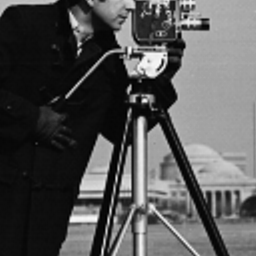

Property    Value
----------  --------------------
width       256
height      256
mode        RGBA
entropy     6.99351919611469
image_band  ('R', 'G', 'B', 'A')
bpp         32.0040283203125


In [7]:
if VIEW_IMAGE:
    import io
    from matplotlib import cm
    import ipywidgets as widgets
    from IPython.display import display

    import torch
    import torchvision.transforms as transforms

    print('=' * 100)
    print('Original Cropped image (Grayscale)')
    print('=' * 100)
    img = Image.fromarray(skimage.data.camera())        
    transform = transforms.Compose([
        transforms.CenterCrop(SIDELENGTH),
        transforms.ToTensor(),
        # transforms.Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img).cpu().view([SIDELENGTH, SIDELENGTH]).detach().numpy()
    img = Image.fromarray(np.uint8(cm.gist_gray(img)*255))
    display(img)

    w, h = img.size
    bpp = sys.getsizeof(img.tobytes()) / (w * h) * 8
    headers = "Property,Value".split(",")
    property_dict = OrderedDict(
        width=w,
        height=h,
        mode=img.mode,
        entropy=img.entropy(),
        image_band=img.getbands(),
        bpp=bpp
    )
    data = list(property_dict.items())
    table = tabulate.tabulate(tabular_data=data, headers=headers)
    print(table)
    # print(tabulate.tabulate(tabular_data=data, headers=headers, tablefmt="latex"))
    pass

In [8]:
im = Image.fromarray(skimage.data.camera())  

Image size: (256, 256)
Property    Value
----------  -----------------
width       256
height      256
mode        L
entropy     6.780318133166338
image_band  ('L',)
bpp         8.0040283203125


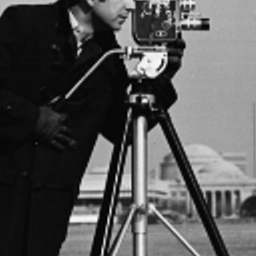

In [9]:
im_cropped = get_cropped_by_center_image(im, target = (SIDELENGTH, SIDELENGTH))
print('Image size:', im_cropped.size)
w, h = im_cropped.size
bpp = sys.getsizeof(im_cropped.tobytes()) / (w * h) * 8
headers = "Property,Value".split(",")
property_dict = OrderedDict(
    width=w,
    height=h,
    mode=im_cropped.mode,
    entropy=im_cropped.entropy(),
    image_band=im_cropped.getbands(),
    bpp=bpp
)
data = list(property_dict.items())
table = tabulate.tabulate(tabular_data=data, headers=headers)
print(table)
# print(tabulate.tabulate(tabular_data=data, headers=headers, tablefmt="latex"))
im_cropped

### Compute Jpeg compression as reference.

In [10]:
# --- Array of qualities to be tested in compression.
qualities_arr = np.arange(20, 95+1, dtype = np.int)

In [11]:
result_tuples, failure_qualities = \
  calculate_several_jpeg_compression(im_cropped, sys.getsizeof(img.tobytes()) , qualities_arr)

In [12]:
# data = list(map(lambda xx: xx._asdict(), result_tuples))
data = list(map(operator.methodcaller('_asdict'), result_tuples))
result_jpeg_df = pd.DataFrame(data = data)

def calc_footprint(a_row, original_image_size = sys.getsizeof(im_cropped.tobytes())):
    file_size_bits = a_row[4]
    return (file_size_bits / 8) / original_image_size * 100
result_jpeg_df['footprint'] = list(map(calc_footprint, result_jpeg_df.values))

In [13]:
result_jpeg_df.head(5)

,mse,psnr,ssim,quality,file_size_bits,bpp,width,heigth,CR,footprint
0,30.618301,33.270993,0.939424,20,33064,0.504517,256,256,7.929379,6.303284
1,28.949783,33.514350,0.940436,21,33968,0.518311,256,256,7.718353,6.475621
2,27.839966,33.684117,0.941620,22,34736,0.530029,256,256,7.547703,6.622032
3,26.316681,33.928492,0.944786,23,35408,0.540283,256,256,7.404457,6.750141
4,25.208344,34.115361,0.946817,24,36000,0.549316,256,256,7.282694,6.862999


In [14]:
# print(result_jpeg_df.head(5).to_latex(index=False))

In [15]:
result_jpeg_df.tail(5)

,mse,psnr,ssim,quality,file_size_bits,bpp,width,heigth,CR,footprint
71,1.694931,45.839283,0.993285,91,119528,1.823853,256,256,2.193436,22.786683
72,1.493744,46.388042,0.993804,92,123880,1.890259,256,256,2.116379,23.616343
73,1.274261,47.078218,0.994504,93,133928,2.043579,256,256,1.957597,25.531882
74,1.072327,47.827533,0.995091,94,145448,2.219360,256,256,1.802548,27.728042
75,0.878433,48.693716,0.995725,95,158904,2.424683,256,256,1.649908,30.293279


In [16]:
# print(result_jpeg_df.tail(5).to_latex(index=False))

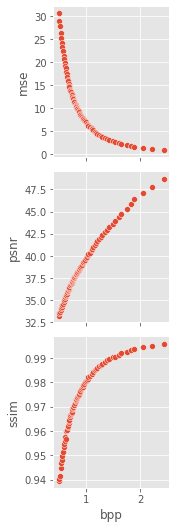

In [17]:
g = sns.PairGrid(data = result_jpeg_df, x_vars=["bpp"], y_vars=["mse", "psnr", "ssim"])
g.map(sns.scatterplot);

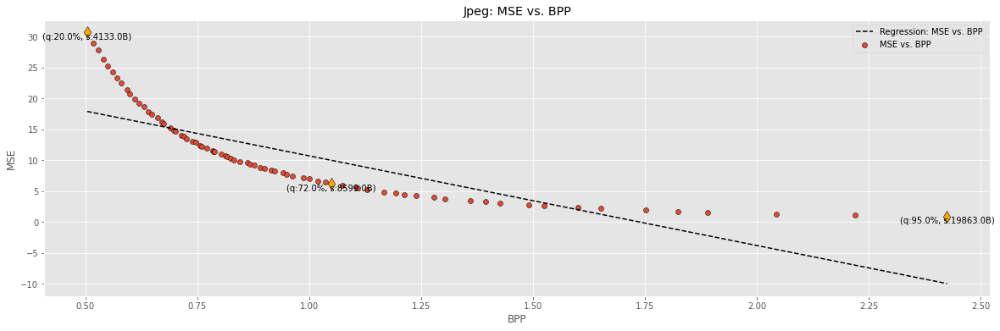

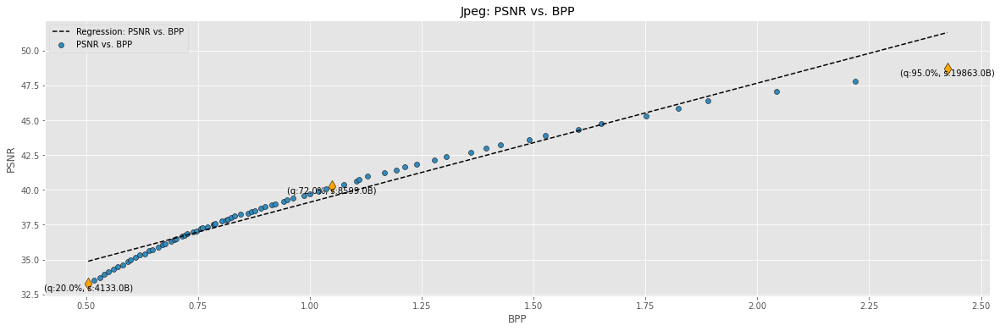

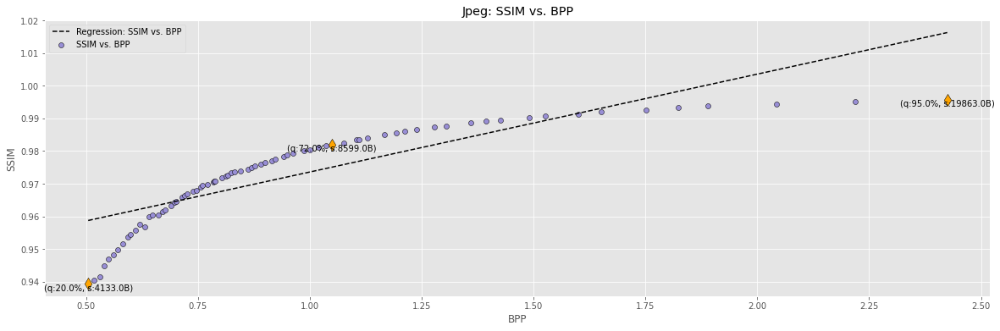

In [18]:
from sklearn import linear_model
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

x_vars=["bpp"]; y_vars=["mse", "psnr", "ssim"]
x = x_vars[0]
# fig, axes = plt.subplots(1, len(y_vars), figsize=(20, 6))
# fig.suptitle("Jpeg Analysis Graph")
colors = sns.color_palette()
for ii, y in enumerate(y_vars):
    fig, ax = plt.subplots(1, 1, figsize=(20, 6))
    # ax = axes[ii]

    regr = make_pipeline(PolynomialFeatures(1), linear_model.LinearRegression())
    # regr = make_pipeline(PolynomialFeatures(4), linear_model.Ridge())
    # regr = linear_model.LinearRegression()
    
    y_arr = result_jpeg_df[f"{y}"].values
    x_arr = result_jpeg_df[f"{x}"].values

    x_arr_np = np.array(x_arr)[:, np.newaxis]
    regr.fit(x_arr_np, y_arr)
    y_pred = regr.predict(x_arr_np)

    ax.plot(x_arr, y_pred, color='black', linestyle='dashed', label = f'Regression: {y.upper()} vs. {x.upper()}')
    ax.scatter(x_arr, y_arr, color=colors[ii], label = f'{y.upper()} vs. {x.upper()}', edgecolors= "black")

    a_record = result_jpeg_df.iloc[0,:]
    ax.scatter(a_record[f"{x}"], a_record[f"{y}"], color='orange', s=100, marker='d', edgecolors= "black")
    # ax.text(a_record[f"{x}"] + 0.40, a_record[f'{y}'] + a_record[f'{y}'] * 0.005, f'(q:{a_record["quality"]}%, s:{a_record["file_size_bits"] /8}B)',
    ax.text(a_record[f"{x}"] + 0.0, a_record[f'{y}'] + a_record[f'{y}'] * 0.0, f'(q:{a_record["quality"]}%, s:{a_record["file_size_bits"] /8}B)',
         rotation=0,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')
    
    a_record = result_jpeg_df.iloc[result_jpeg_df.shape[0]-100,:]
    ax.scatter(a_record[f"{x}"], a_record[f"{y}"], color='orange', s=100, marker='d', edgecolors= "black")
    # ax.text(a_record[f"{x}"] - 0.35, a_record[f'{y}'] + a_record[f'{y}'] * 0.0009, f'(q:{a_record["quality"]}%, s:{a_record["file_size_bits"] /8}B)',
    ax.text(a_record[f"{x}"] - 0.0, a_record[f'{y}'] + a_record[f'{y}'] * 0.0, f'(q:{a_record["quality"]}%, s:{a_record["file_size_bits"] /8}B)',
         rotation=0,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

    a_record = result_jpeg_df.iloc[-1,:]
    ax.scatter(a_record[f"{x}"], a_record[f"{y}"], color='orange', s=100, marker='d', edgecolors= "black")
    # ax.text(a_record[f"{x}"] - 0.25, a_record[f'{y}'] + a_record[f'{y}'] * 0.005, f'(q:{a_record["quality"]}%, s:{a_record["file_size_bits"] /8}B)',
    ax.text(a_record[f"{x}"] - 0.0, a_record[f'{y}'] + a_record[f'{y}'] * 0, f'(q:{a_record["quality"]}%, s:{a_record["file_size_bits"] /8}B)',
         rotation=0,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

    ax.set_title(f'Jpeg: {y.upper()} vs. {x.upper()}')
    ax.set_xlabel(f'{x.upper()}')
    ax.legend()
    ax.set_ylabel(f'{y.upper()}')
    fig.savefig(f"/content/{x}_vs_{y}.png")
    pass

In [19]:
def calc_drop(a_row, original_image_size = sys.getsizeof(im_cropped.tobytes())):
    n_weigths = a_row[4] / 8
    return (original_image_size - n_weigths) / original_image_size * 100
result_jpeg_df['drop'] = list(map(calc_drop, result_jpeg_df.values))

In [20]:
min(result_jpeg_df['psnr'].values), max(result_jpeg_df['psnr'].values)

(33.270992671482716, 48.693716058657934)

### Show plots

In [21]:
n_hf_list = list(map(int,"8,9,10,11,12,16,20,24,30,32,35,40,45,50,55,60,64,70".split(",")))
n_hl_list = list(map(int,"5,6,7,8,9,10,11,12,13,14,15,16,17,20".split(",")))
comb_list = itertools.product(n_hf_list, n_hl_list)

def calc_num_weigths(a_row):
    n_hf, n_hl = a_row
    return (n_hf * 2 + n_hf) + (n_hf * n_hf * n_hl + n_hf * n_hl) + (n_hf + 1)


def calc_bpp(a_row, w = 256, h = 256):
    n_weigths = a_row[2]
    return n_weigths * 8 * 4 / (w * h)

def calc_file_size_bits(a_row):
    n_weigths = a_row[2]
    return n_weigths * 8 * 4

def calc_drop(a_row, original_image_size = sys.getsizeof(im_cropped.tobytes())):
    n_weigths = a_row[2]
    return (original_image_size - n_weigths) / original_image_size * 100

def calc_footprint(a_row, original_image_size = sys.getsizeof(im_cropped.tobytes())):
    n_weigths = a_row[2]
    return (n_weigths) / original_image_size * 100


df_hyperparams = pd.DataFrame(data = comb_list, columns = ["n_hf", "n_hl"])

df_hyperparams['n_weigths'] = list(map(calc_num_weigths, df_hyperparams.values))
df_hyperparams['file_size_bits'] = list(map(calc_file_size_bits, df_hyperparams.values))
df_hyperparams['bpp'] = list(map(calc_bpp, df_hyperparams.values))
df_hyperparams['drop'] = list(map(calc_drop, df_hyperparams.values))
df_hyperparams['footprint'] = list(map(calc_footprint, df_hyperparams.values))

In [22]:
df_hyperparams.head(5)

,n_hf,n_hl,n_weigths,file_size_bits,bpp,drop,footprint
0,8,5,393,12576,0.191895,99.400631,0.599369
1,8,6,465,14880,0.227051,99.290823,0.709177
2,8,7,537,17184,0.262207,99.181015,0.818985
3,8,8,609,19488,0.297363,99.071207,0.928793
4,8,9,681,21792,0.332520,98.961399,1.038601


In [23]:
df_hyperparams.tail(5)

,n_hf,n_hl,n_weigths,file_size_bits,bpp,drop,footprint
247,70,14,69861,2235552,34.111816,-6.545776,106.545776
248,70,15,74831,2394592,36.538574,-14.125578,114.125578
249,70,16,79801,2553632,38.965332,-21.705379,121.705379
250,70,17,84771,2712672,41.392090,-29.285180,129.285180
251,70,20,99681,3189792,48.672363,-52.024585,152.024585


In [24]:
hue = 'n_hf'; x = 'bpp'; y = 'n_weigths'
hover_data = ['n_hf', 'n_hl', 'n_weigths']
fig = px.scatter(df_hyperparams[:], y=f"{y}", color=f"{hue}", x=f"{x}",
                 hover_data = hover_data,
                 template=DASH_TEMPLATES_LIST[2])
fig.update_layout(template = DASH_TEMPLATES_LIST[2], title_text=f'{y.upper()} | Groupped by {hue} | dataframes')
fig.show()

In [25]:
hue = 'n_hf'; x = 'bpp'; y = 'drop'
hover_data = ['n_hf', 'n_hl', 'n_weigths', 'drop']
fig = px.scatter(df_hyperparams[:], y=f"{y}", color=f"{hue}", x=f"{x}",
                 hover_data = hover_data,
                 template=DASH_TEMPLATES_LIST[2])
fig.update_layout(template = DASH_TEMPLATES_LIST[2], title_text=f'{y.upper()} | Groupped by {hue} | dataframes')
fig.show()

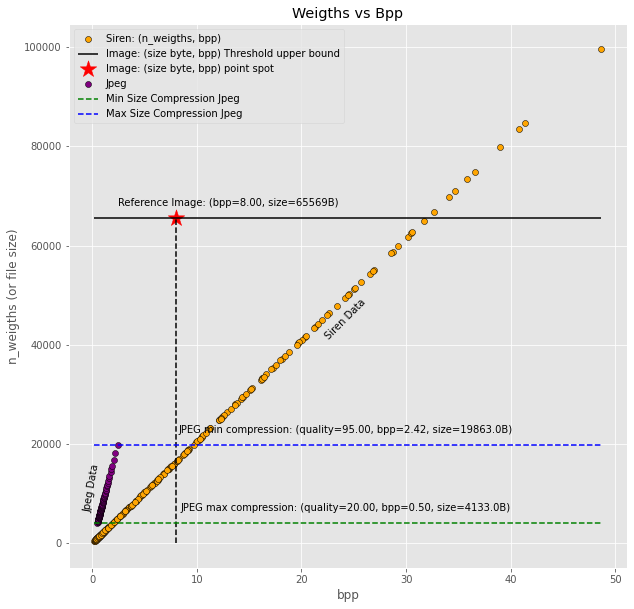

In [26]:
fig = plt.figure(figsize = (10, 10))

bpp_scores = df_hyperparams['bpp'].values
n_weigths_values = df_hyperparams['n_weigths'].values

middle_pos = (max(bpp_scores) - min(bpp_scores)) / 2
middle_pos_x = (max(bpp_scores) - min(bpp_scores)) / 2
middle_pos_y = (max(n_weigths_values) - min(n_weigths_values)) / 2

original_image_size = sys.getsizeof(im_cropped.tobytes())

min_size_jpeg = min(result_jpeg_df['file_size_bits'].values) / 8
bpp_min_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['bpp'].values[0]
compression_rate_min = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['quality'].values[0]
max_size_jpeg = max(result_jpeg_df['file_size_bits'].values) / 8
bpp_max_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['bpp'].values[0]
compression_rate_max = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['quality'].values[0]

plt.scatter(bpp_scores, n_weigths_values, color='orange', label='Siren: (n_weigths, bpp)', edgecolors= "black")
plt.text(middle_pos_x, middle_pos_y, f'Siren Data',
         rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Original Image Data
plt.hlines(y = original_image_size, xmin = min(bpp_scores), xmax = max(bpp_scores), color='black', label='Image: (size byte, bpp) Threshold upper bound')
plt.vlines(x = bpp, ymin = 0, ymax = original_image_size, color='black', linestyles ='dashed')
plt.scatter(bpp, original_image_size, color = 'red', s=300, marker='*', label='Image: (size byte, bpp) point spot')
plt.text(bpp + 5, original_image_size+ 4000, f'Reference Image: (bpp={bpp:.2f}, size={original_image_size}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Jpeg Compressed Image Data
result_jpeg_df['file_size_bite'] = (result_jpeg_df['file_size_bits'].values) / 8
plt.scatter(result_jpeg_df['bpp'], result_jpeg_df['file_size_bite'], color='purple', label='Jpeg', edgecolors= "black")
middle_pos_x = (max(result_jpeg_df['bpp']) - min(result_jpeg_df['bpp'])) / 2 - 1
middle_pos_y = (max_size_jpeg -min_size_jpeg) / 2 + min_size_jpeg + 4000
plt.text(middle_pos_x, middle_pos_y, f'Jpeg Data',
         rotation=80,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.hlines(y = min_size_jpeg, xmin = min(bpp_scores), xmax = max(bpp_scores), color='green', linestyles ='dashed', label='Min Size Compression Jpeg')
plt.hlines(y = max_size_jpeg, xmin = min(bpp_scores), xmax = max(bpp_scores), color='blue', linestyles ='dashed', label='Max Size Compression Jpeg')
plt.text(middle_pos, min_size_jpeg + 4000, f'JPEG max compression: (quality={compression_rate_min:.2f}, bpp={bpp_min_size_jpge:.2f}, size={min_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')
plt.text(middle_pos, max_size_jpeg + 4000, f'JPEG min compression: (quality={compression_rate_max:.2f}, bpp={bpp_max_size_jpge:.2f}, size={max_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.title("Weigths vs Bpp")
plt.xlabel('bpp')
plt.ylabel('n_weigths (or file size)')
plt.legend()
plt.show()

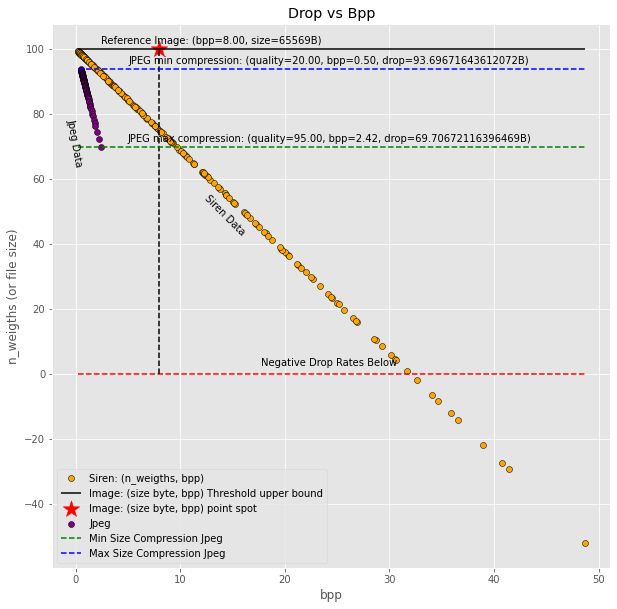

In [27]:
fig = plt.figure(figsize = (10, 10))

bpp_scores = df_hyperparams['bpp'].values
n_weigths_values = df_hyperparams['drop'].values

middle_pos = (max(bpp_scores) - min(bpp_scores)) / 2
middle_pos_x = (max(bpp_scores) - min(bpp_scores)) / 2 - 10
middle_pos_y = (max(n_weigths_values) - min(n_weigths_values)) / 2 - 20

drop_original_image = 100. # sys.getsizeof(im_cropped.tobytes())
original_image_size = sys.getsizeof(im_cropped.tobytes())

target_attribute = 'drop'

min_size_jpeg = min(result_jpeg_df[f'{target_attribute}'].values)
bpp_min_size_jpge = result_jpeg_df[result_jpeg_df[f'{target_attribute}'] == (min_size_jpeg)]['bpp'].values[0]
compression_rate_min = result_jpeg_df[result_jpeg_df[f'{target_attribute}'] == (min_size_jpeg)]['quality'].values[0]
max_size_jpeg = max(result_jpeg_df[f'{target_attribute}'].values)
bpp_max_size_jpge = result_jpeg_df[result_jpeg_df[f'{target_attribute}'] == (max_size_jpeg)]['bpp'].values[0]
compression_rate_max = result_jpeg_df[result_jpeg_df[f'{target_attribute}'] == (max_size_jpeg )]['quality'].values[0]

plt.scatter(bpp_scores, n_weigths_values, color='orange', label='Siren: (n_weigths, bpp)', edgecolors= "black")
plt.text(middle_pos_x, middle_pos_y, f'Siren Data',
         rotation=-45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Original Image Data
plt.hlines(y = drop_original_image, xmin = min(bpp_scores), xmax = max(bpp_scores), color='black', label='Image: (size byte, bpp) Threshold upper bound')
plt.hlines(y = 0, xmin = min(bpp_scores), xmax = max(bpp_scores), color='red', linestyles ='dashed')
plt.vlines(x = bpp, ymin = 0, ymax = drop_original_image, color='black', linestyles ='dashed')
plt.scatter(bpp, drop_original_image, color = 'red', s=300, marker='*', label='Image: (size byte, bpp) point spot')
plt.text(bpp + 5, drop_original_image+ 4, f'Reference Image: (bpp={bpp:.2f}, size={original_image_size}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')
plt.text(middle_pos, 0 + 5, f'Negative Drop Rates Below',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Jpeg Compressed Image Data
result_jpeg_df[f'{target_attribute}'] = (result_jpeg_df[f'{target_attribute}'].values)
plt.scatter(result_jpeg_df['bpp'], result_jpeg_df[f'{target_attribute}'], color='purple', label='Jpeg', edgecolors= "black")
middle_pos_x = (max(result_jpeg_df['bpp']) - min(result_jpeg_df['bpp'])) / 2 - 1
middle_pos_y = (max_size_jpeg -min_size_jpeg) / 2 + min_size_jpeg - 3
plt.text(middle_pos_x, middle_pos_y, f'Jpeg Data',
         rotation=-80,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.hlines(y = min_size_jpeg, xmin = min(bpp_scores), xmax = max(bpp_scores), color='green', linestyles ='dashed', label='Min Size Compression Jpeg')
plt.hlines(y = max_size_jpeg, xmin = min(bpp_scores), xmax = max(bpp_scores), color='blue', linestyles ='dashed', label='Max Size Compression Jpeg')
plt.text(middle_pos, min_size_jpeg + 4, f'JPEG max compression: (quality={compression_rate_min:.2f}, bpp={bpp_min_size_jpge:.2f}, drop={min_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')
plt.text(middle_pos, max_size_jpeg + 4, f'JPEG min compression: (quality={compression_rate_max:.2f}, bpp={bpp_max_size_jpge:.2f}, drop={max_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.title("Drop vs Bpp")
plt.xlabel('bpp')
plt.ylabel('n_weigths (or file size)')
# plt.legend(loc='lower right')
plt.legend(loc='lower left')
plt.show()

In [28]:
df = copy.deepcopy(df_hyperparams)

In [29]:
n_hf_list = list(map(int,"45,50,64,45,50,64,64,70,55,45,40,50,64,70,60".split(",")))
n_hl_list = list(map(int,"10,8,5,16,13,8,10,8,13,12,14,9,15,12,15".split(",")))
comb_list = list(zip(n_hf_list, n_hl_list))

def calc_num_weigths(a_row):
    n_hf, n_hl = a_row
    return (n_hf * 2 + n_hf) + (n_hf * n_hf * n_hl + n_hf * n_hl) + (n_hf + 1)
df_hyperparams = pd.DataFrame(data = comb_list, columns = ["n_hf", "n_hl"])

def calc_bpp(a_row, w = 256, h = 256):
    n_weigths = a_row[2]
    return n_weigths * 8 * 4 / (w * h)

df_hyperparams['n_weigths'] = list(map(calc_num_weigths, df_hyperparams.values))
df_hyperparams['bpp'] = list(map(calc_bpp, df_hyperparams.values))

In [30]:
df_hyperparams.head(5)

,n_hf,n_hl,n_weigths,bpp
0,45,10,20881,10.195801
1,50,8,20601,10.059082
2,64,5,21057,10.281738
3,45,16,33301,16.260254
4,50,13,33351,16.284668


In [31]:
hue = 'n_hf'; x = 'bpp'; y = 'n_weigths'
hover_data = ['n_hf', 'n_hl', 'n_weigths']
fig = px.scatter(df_hyperparams[:], y=f"{y}", color=f"{hue}", x=f"{x}",
                 hover_data = hover_data,
                 template=DASH_TEMPLATES_LIST[2])
fig.update_layout(template = DASH_TEMPLATES_LIST[2], title_text=f'{y.upper()} | Groupped by {hue} | dataframes')
fig.show()

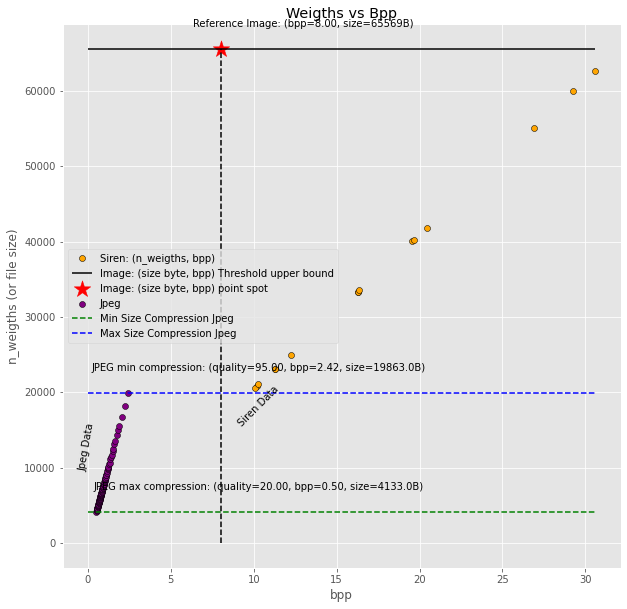

In [32]:
fig = plt.figure(figsize = (10, 10))

bpp_scores = df_hyperparams['bpp'].values
n_weigths_values = df_hyperparams['n_weigths'].values

middle_pos = (max(bpp_scores) - min(bpp_scores)) / 2
middle_pos_x = (max(bpp_scores) - min(bpp_scores)) / 2
middle_pos_y = (max(n_weigths_values) - min(n_weigths_values)) / 2

original_image_size = sys.getsizeof(im_cropped.tobytes())

min_size_jpeg = min(result_jpeg_df['file_size_bits'].values) / 8
bpp_min_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['bpp'].values[0]
compression_rate_min = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['quality'].values[0]
max_size_jpeg = max(result_jpeg_df['file_size_bits'].values) / 8
bpp_max_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['bpp'].values[0]
compression_rate_max = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['quality'].values[0]

plt.scatter(bpp_scores, n_weigths_values, color='orange', label='Siren: (n_weigths, bpp)', edgecolors= "black")
plt.text(middle_pos_x, middle_pos_y, f'Siren Data',
         rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Original Image Data
plt.hlines(y = original_image_size, xmin = 0, xmax = max(bpp_scores), color='black', label='Image: (size byte, bpp) Threshold upper bound')
plt.vlines(x = bpp, ymin = 0, ymax = original_image_size, color='black', linestyles ='dashed')
plt.scatter(bpp, original_image_size, color = 'red', s=300, marker='*', label='Image: (size byte, bpp) point spot')
plt.text(bpp + 5, original_image_size+ 4000, f'Reference Image: (bpp={bpp:.2f}, size={original_image_size}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Jpeg Compressed Image Data
result_jpeg_df['file_size_bite'] = (result_jpeg_df['file_size_bits'].values) / 8
plt.scatter(result_jpeg_df['bpp'], result_jpeg_df['file_size_bite'], color='purple', label='Jpeg', edgecolors= "black")
middle_pos_x = (max(result_jpeg_df['bpp']) - min(result_jpeg_df['bpp'])) / 2 - 1
middle_pos_y = (max_size_jpeg -min_size_jpeg) / 2 + min_size_jpeg + 4000
plt.text(middle_pos_x, middle_pos_y, f'Jpeg Data',
         rotation=80,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.hlines(y = min_size_jpeg, xmin = 0, xmax = max(bpp_scores), color='green', linestyles ='dashed', label='Min Size Compression Jpeg')
plt.hlines(y = max_size_jpeg, xmin = 0, xmax = max(bpp_scores), color='blue', linestyles ='dashed', label='Max Size Compression Jpeg')
plt.text(middle_pos, min_size_jpeg + 4000, f'JPEG max compression: (quality={compression_rate_min:.2f}, bpp={bpp_min_size_jpge:.2f}, size={min_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')
plt.text(middle_pos, max_size_jpeg + 4000, f'JPEG min compression: (quality={compression_rate_max:.2f}, bpp={bpp_max_size_jpge:.2f}, size={max_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.title("Weigths vs Bpp")
plt.xlabel('bpp')
plt.ylabel('n_weigths (or file size)')
plt.legend(loc='center left')
plt.show()

### Final Choices

In [33]:
n_hf_list = list(map(int,"45,50,64,35,40,50".split(",")))
n_hl_list = list(map(int,"10,8,5,12,9,6".split(",")))
labels = "very-deep,medium-deep,low-deep,very-deep,medium-deep,low-deep".split(",")
labels_2 = "bpp_r,bpp_r,bpp_r,bpp_l,bpp_l,bpp_l".split(",")
comb_list = list(zip(n_hf_list, n_hl_list, labels, labels_2))

def calc_num_weigths(a_row):
    n_hf, n_hl, _, _ = a_row
    return (n_hf * 2 + n_hf) + (n_hf * n_hf * n_hl + n_hf * n_hl) + (n_hf + 1)
df_hyperparams = pd.DataFrame(data = comb_list, columns = ["n_hf", "n_hl", "labels", "labels_2"])

def calc_bpp(a_row, w = 256, h = 256):
    n_weigths = a_row[4]
    return n_weigths * 8 * 4 / (w * h)

def calc_drop(a_row, original_image_size = sys.getsizeof(im_cropped.tobytes())):
    n_weigths = a_row[4]
    return (original_image_size - n_weigths) / original_image_size * 100

def calc_footprint(a_row, original_image_size = sys.getsizeof(im_cropped.tobytes())):
    n_weigths = a_row[4]
    return (n_weigths) / original_image_size * 100

def calc_cr(a_row, original_image_size = sys.getsizeof(im_cropped.tobytes())):
    n_weigths = a_row[4]
    return original_image_size / n_weigths

df_hyperparams['n_weigths'] = list(map(calc_num_weigths, df_hyperparams.values))
df_hyperparams['bpp'] = list(map(calc_bpp, df_hyperparams.values))
df_hyperparams['drop'] = list(map(calc_drop, df_hyperparams.values))

df_hyperparams['drop'] = list(map(calc_drop, df_hyperparams.values))
df_hyperparams['CR'] = list(map(calc_cr, df_hyperparams.values))
df_hyperparams['footprint'] = list(map(calc_footprint, df_hyperparams.values))

In [34]:
df_hyperparams.drop(['drop'], axis = 1).head(6)

,n_hf,n_hl,labels,labels_2,n_weigths,bpp,CR,footprint
0,45,10,very-deep,bpp_r,20881,10.195801,3.140127,31.845842
1,50,8,medium-deep,bpp_r,20601,10.059082,3.182807,31.418811
2,64,5,low-deep,bpp_r,21057,10.281738,3.113881,32.114261
3,35,12,very-deep,bpp_l,15261,7.451660,4.296507,23.274718
4,40,9,medium-deep,bpp_l,14921,7.285645,4.394411,22.756181
5,50,6,low-deep,bpp_l,15501,7.568848,4.229985,23.640745


In [35]:
print(df_hyperparams.drop(['drop'], axis = 1).head(df_hyperparams.shape[0]).to_latex(index=False))

\begin{tabular}{rrllrrrr}
\toprule
 n\_hf &  n\_hl &       labels & labels\_2 &  n\_weigths &        bpp &        CR &  footprint \\
\midrule
   45 &    10 &    very-deep &    bpp\_r &      20881 &  10.195801 &  3.140127 &  31.845842 \\
   50 &     8 &  medium-deep &    bpp\_r &      20601 &  10.059082 &  3.182807 &  31.418811 \\
   64 &     5 &     low-deep &    bpp\_r &      21057 &  10.281738 &  3.113881 &  32.114261 \\
   35 &    12 &    very-deep &    bpp\_l &      15261 &   7.451660 &  4.296507 &  23.274718 \\
   40 &     9 &  medium-deep &    bpp\_l &      14921 &   7.285645 &  4.394411 &  22.756181 \\
   50 &     6 &     low-deep &    bpp\_l &      15501 &   7.568848 &  4.229985 &  23.640745 \\
\bottomrule
\end{tabular}



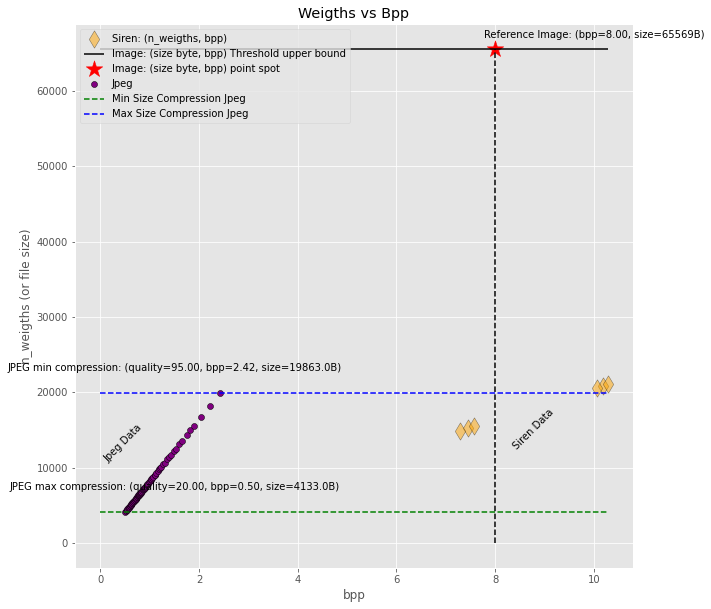

In [36]:
fig = plt.figure(figsize = (10, 10))

bpp_scores = df_hyperparams['bpp'].values
n_weigths_values = df_hyperparams['n_weigths'].values

middle_pos = (max(bpp_scores) - min(bpp_scores)) / 2
middle_pos_x = (max(bpp_scores) - min(bpp_scores)) / 2
middle_pos_y = (max(n_weigths_values) - min(n_weigths_values)) / 2

original_image_size = sys.getsizeof(im_cropped.tobytes())

min_size_jpeg = min(result_jpeg_df['file_size_bits'].values) / 8
bpp_min_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['bpp'].values[0]
compression_rate_min = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['quality'].values[0]
max_size_jpeg = max(result_jpeg_df['file_size_bits'].values) / 8
bpp_max_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['bpp'].values[0]
compression_rate_max = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['quality'].values[0]

plt.scatter(bpp_scores, n_weigths_values, color='orange', s=150, marker='d', alpha=0.5, label='Siren: (n_weigths, bpp)', edgecolors= "black")
plt.text(middle_pos_x + min(bpp_scores), middle_pos_y + min(n_weigths_values), f'Siren Data',
         rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Original Image Data
plt.hlines(y = original_image_size, xmin = 0, xmax = max(bpp_scores), color='black', label='Image: (size byte, bpp) Threshold upper bound')
plt.vlines(x = bpp, ymin = 0, ymax = original_image_size, color='black', linestyles ='dashed')
plt.scatter(bpp, original_image_size, color = 'red', s=300, marker='*', label='Image: (size byte, bpp) point spot')
plt.text(bpp + 2, original_image_size+ 2500, f'Reference Image: (bpp={bpp:.2f}, size={original_image_size}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Jpeg Compressed Image Data
result_jpeg_df['file_size_bite'] = (result_jpeg_df['file_size_bits'].values) / 8
plt.scatter(result_jpeg_df['bpp'], result_jpeg_df['file_size_bite'], color='purple', label='Jpeg', edgecolors= "black")
middle_pos_x = (max(result_jpeg_df['bpp']) - min(result_jpeg_df['bpp'])) / 2 - 1 + min(result_jpeg_df['bpp'])
middle_pos_y = (max_size_jpeg -min_size_jpeg) / 2 + min_size_jpeg + 4000
plt.text(middle_pos_x, middle_pos_y, f'Jpeg Data',
         rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.hlines(y = min_size_jpeg, xmin = 0, xmax = max(bpp_scores), color='green', linestyles ='dashed', label='Min Size Compression Jpeg')
plt.hlines(y = max_size_jpeg, xmin = 0, xmax = max(bpp_scores), color='blue', linestyles ='dashed', label='Max Size Compression Jpeg')
plt.text(middle_pos, min_size_jpeg + 4000, f'JPEG max compression: (quality={compression_rate_min:.2f}, bpp={bpp_min_size_jpge:.2f}, size={min_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')
plt.text(middle_pos, max_size_jpeg + 4000, f'JPEG min compression: (quality={compression_rate_max:.2f}, bpp={bpp_max_size_jpge:.2f}, size={max_size_jpeg}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.title("Weigths vs Bpp")
plt.xlabel('bpp')
plt.ylabel('n_weigths (or file size)')
plt.legend()
plt.show()

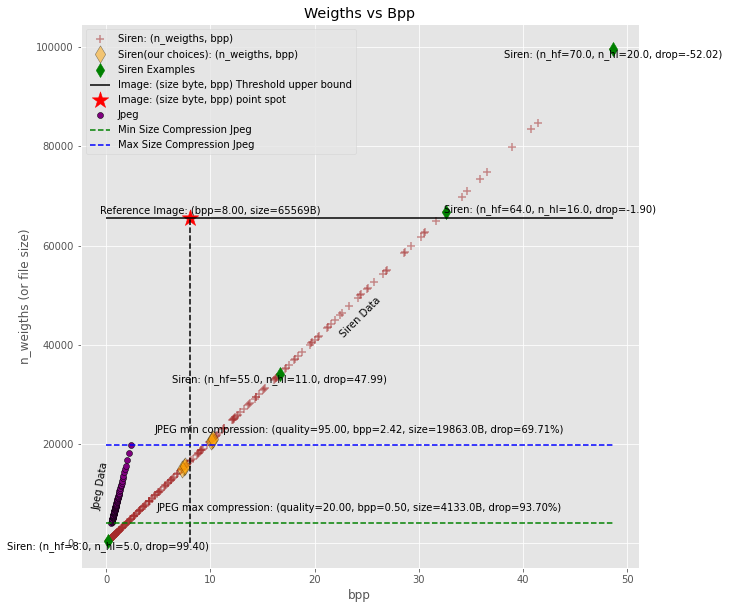

In [37]:
fig = plt.figure(figsize = (10, 10))

bpp_scores = df_hyperparams['bpp'].values
n_weigths_values = df_hyperparams['n_weigths'].values

coors_list = []

middle_pos = (max(df['bpp'].values) - min(df['bpp'].values)) / 2
middle_pos_x = (max(df['bpp'].values) - min(df['bpp'].values)) / 2
middle_pos_y = (max(df['n_weigths'].values) - min(df['n_weigths'].values)) / 2

original_image_size = sys.getsizeof(im_cropped.tobytes())

min_size_jpeg = min(result_jpeg_df['file_size_bits'].values) / 8
bpp_min_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['bpp'].values[0]
compression_rate_min = result_jpeg_df[result_jpeg_df['file_size_bits'] == (min_size_jpeg * 8)]['quality'].values[0]
max_size_jpeg = max(result_jpeg_df['file_size_bits'].values) / 8
bpp_max_size_jpge = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['bpp'].values[0]
compression_rate_max = result_jpeg_df[result_jpeg_df['file_size_bits'] == (max_size_jpeg * 8)]['quality'].values[0]


plt.scatter(df['bpp'].values, df['n_weigths'].values, color='brown', s=50, marker='+', alpha=0.5, label='Siren: (n_weigths, bpp)', edgecolors= "black")
a_record = df.iloc[0, :]
coors_list.append((a_record['bpp'], a_record['n_weigths']))
plt.text(a_record['bpp'], a_record['n_weigths'], f"Siren: (n_hf={a_record['n_hf']}, n_hl={a_record['n_hl']}, drop={a_record['drop']:.2f})",
         rotation=0,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

a_record = df.iloc[df.shape[0] - 50, :]
coors_list.append((a_record['bpp'], a_record['n_weigths']))
plt.text(a_record['bpp'], a_record['n_weigths'], f"Siren: (n_hf={a_record['n_hf']}, n_hl={a_record['n_hl']}, drop={a_record['drop']:.2f})",
         rotation=0,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

a_record = df[df["n_weigths"] > original_image_size].sort_values(["bpp"]).iloc[0, :]
coors_list.append((a_record['bpp'], a_record['n_weigths']))
plt.text(a_record['bpp'] + 10, a_record['n_weigths'] + 1500, f"Siren: (n_hf={a_record['n_hf']}, n_hl={a_record['n_hl']}, drop={a_record['drop']:.2f})",
         rotation=0,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

a_record = df.iloc[-1, :]
coors_list.append((a_record['bpp'], a_record['n_weigths']))
plt.text(a_record['bpp'], a_record['n_weigths'], f"Siren: (n_hf={a_record['n_hf']}, n_hl={a_record['n_hl']}, drop={a_record['drop']:.2f})",
         rotation=0,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.scatter(bpp_scores, n_weigths_values, color='orange', s=150, marker='d', alpha=0.5, label='Siren(our choices): (n_weigths, bpp)', edgecolors= "black")
# plt.scatter(result_jpeg_df['bpp'], result_jpeg_df['file_size_bite'], color='purple', label='Jpeg', edgecolors= "black")
plt.text(middle_pos_x + min(df['bpp'].values), middle_pos_y + min(df['n_weigths'].values), f'Siren Data',
         rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

coors_list_arr = np.array(coors_list)
plt.scatter(coors_list_arr[:, 0], coors_list_arr[:, 1], color = 'green', s=100, marker='d', label='Siren Examples')

# Original Image Data
plt.hlines(y = original_image_size, xmin = 0, xmax = max(df['bpp'].values), color='black', label='Image: (size byte, bpp) Threshold upper bound')
plt.vlines(x = bpp, ymin = 0, ymax = original_image_size, color='black', linestyles ='dashed')
plt.scatter(bpp, original_image_size, color = 'red', s=300, marker='*', label='Image: (size byte, bpp) point spot')
plt.text(bpp + 2, original_image_size+ 2500, f'Reference Image: (bpp={bpp:.2f}, size={original_image_size}B)',
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

# Jpeg Compressed Image Data
result_jpeg_df['file_size_bite'] = (result_jpeg_df['file_size_bits'].values) / 8
plt.scatter(result_jpeg_df['bpp'], result_jpeg_df['file_size_bite'], color='purple', label='Jpeg', edgecolors= "black")
middle_pos_x = (max(result_jpeg_df['bpp']) - min(result_jpeg_df['bpp'])) / 2 - 2 + min(result_jpeg_df['bpp'])
middle_pos_y = (max_size_jpeg -min_size_jpeg) / 2 + min_size_jpeg + 4500
plt.text(middle_pos_x, middle_pos_y, f'Jpeg Data',
         rotation=80,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.hlines(y = min_size_jpeg, xmin = 0, xmax = max(df['bpp'].values), color='green', linestyles ='dashed', label='Min Size Compression Jpeg')
plt.hlines(y = max_size_jpeg, xmin = 0, xmax = max(df['bpp'].values), color='blue', linestyles ='dashed', label='Max Size Compression Jpeg')
info_text = f'JPEG max compression: (quality={compression_rate_min:.2f}, bpp={bpp_min_size_jpge:.2f}, size={min_size_jpeg}B, drop={(original_image_size-min_size_jpeg)/original_image_size*100:.2f}%)'
plt.text(middle_pos, min_size_jpeg + 4000, f"{info_text}",
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')
info_text = f'JPEG min compression: (quality={compression_rate_max:.2f}, bpp={bpp_max_size_jpge:.2f}, size={max_size_jpeg}B, drop={(original_image_size- max_size_jpeg)/original_image_size*100:.2f}%)'
plt.text(middle_pos, max_size_jpeg + 4000, f"{info_text}",
         # rotation=45,
         horizontalalignment='center',
         verticalalignment='top',
         multialignment='center')

plt.title("Weigths vs Bpp")
plt.xlabel('bpp')
plt.ylabel('n_weigths (or file size)')
plt.legend()
plt.show()

### Sampling degree of sparsity to be tested

In [38]:
n_hf = 64
n_hl = 5
w, h = 256, 256
baseline_size = (n_hf * 2 + n_hf) + (n_hf * n_hf * n_hl + n_hf * n_hl) + (n_hf + 1)

ranges_list = [np.arange(0.05, 0.65, 0.05) for _ in range(0, n_hl)]
comb_ranges = itertools.product(*ranges_list)

In [39]:
records = []
for comb in comb_ranges:
    comb_arr = np.array(comb)
    res_tmp = comb_arr * (n_hf * n_hf)
    res_tmp.round(0)
    compress_size = (n_hf * 2 + n_hf) + (res_tmp.sum() +  n_hf * n_hl) + (n_hf + 1)
    compress_size_p = compress_size / baseline_size * 100.0
    a_record = list(comb)  + list(res_tmp) + [compress_size, compress_size_p]
    records.append(a_record)
    pass

In [40]:
columns = [f"%_{ii}" for ii in range(1, n_hl+1)] + [f"l_{ii}" for ii in range(1, n_hl+1)] + ['tot', 'tot%']
df = pd.DataFrame(data = records, columns = columns)
df['bpp_32'] = df['tot'].values * 32 / (w * h)
df['bpp_16'] = df['tot'].values * 16 / (w * h)
df['bpp_8'] = df['tot'].values * 8 / (w * h)
df.head(5)

,%_1,%_2,%_3,%_4,%_5,l_1,l_2,l_3,l_4,l_5,tot,tot%,bpp_32,bpp_16,bpp_8
0,0.05,0.05,0.05,0.05,0.05,204.8,204.8,204.8,204.8,204.8,1601.0,7.603172,0.781738,0.390869,0.195435
1,0.05,0.05,0.05,0.05,0.10,204.8,204.8,204.8,204.8,409.6,1805.8,8.575771,0.881738,0.440869,0.220435
2,0.05,0.05,0.05,0.05,0.15,204.8,204.8,204.8,204.8,614.4,2010.6,9.548369,0.981738,0.490869,0.245435
3,0.05,0.05,0.05,0.05,0.20,204.8,204.8,204.8,204.8,819.2,2215.4,10.520967,1.081738,0.540869,0.270435
4,0.05,0.05,0.05,0.05,0.25,204.8,204.8,204.8,204.8,1024.0,2420.2,11.493565,1.181738,0.590869,0.295435


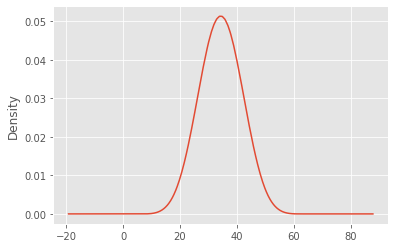

In [41]:
df['tot%'].plot.kde()

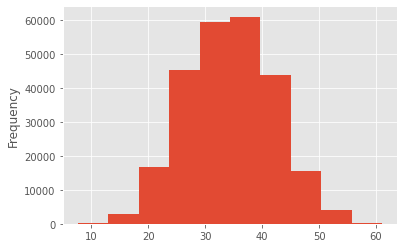

In [42]:
df['tot%'].plot.hist()

In [43]:
interval = df[(df['tot%'] >= 30) & (df['tot%'] < 40)]['tot%'].values.round(0).astype(dtype=np.int)

In [44]:
pd.DataFrame(data = collections.Counter(interval).items(), columns = ("drop_rate_approx", "occurrences"))

,drop_rate_approx,occurrences
0,31,11385
1,32,11901
2,33,12255
3,34,12435
4,35,12435
5,36,12255
6,37,11901
7,38,11385
8,39,10725
9,40,9945


In [45]:
df[(df['tot%'] >= 34) & (df['tot%'] <= 35)].sample(n=5)

,%_1,%_2,%_3,%_4,%_5,l_1,l_2,l_3,l_4,l_5,tot,tot%,bpp_32,bpp_16,bpp_8
149672,0.40,0.15,0.40,0.25,0.45,1638.4,614.4,1638.4,1024.0,1843.2,7335.4,34.835922,3.581738,1.790869,0.895435
237144,0.60,0.30,0.15,0.55,0.05,2457.6,1228.8,614.4,2252.8,204.8,7335.4,34.835922,3.581738,1.790869,0.895435
102867,0.25,0.60,0.35,0.25,0.20,1024.0,2457.6,1433.6,1024.0,819.2,7335.4,34.835922,3.581738,1.790869,0.895435
76137,0.20,0.45,0.05,0.45,0.50,819.2,1843.2,204.8,1843.2,2048.0,7335.4,34.835922,3.581738,1.790869,0.895435
96146,0.25,0.40,0.40,0.45,0.15,1024.0,1638.4,1638.4,1843.2,614.4,7335.4,34.835922,3.581738,1.790869,0.895435


In [46]:
df[(df['tot%'] >= 40) & (df['tot%'] <= 41)].sample(n=5)

,%_1,%_2,%_3,%_4,%_5,l_1,l_2,l_3,l_4,l_5,tot,tot%,bpp_32,bpp_16,bpp_8
103126,0.25,0.60,0.45,0.1,0.55,1024.0,2457.6,1843.2,409.6,2252.8,8564.2,40.671511,4.181738,2.090869,1.045435
103621,0.25,0.60,0.60,0.4,0.10,1024.0,2457.6,2457.6,1638.4,409.6,8564.2,40.671511,4.181738,2.090869,1.045435
141186,0.35,0.50,0.45,0.3,0.35,1433.6,2048.0,1843.2,1228.8,1433.6,8564.2,40.671511,4.181738,2.090869,1.045435
178410,0.45,0.40,0.15,0.6,0.35,1843.2,1638.4,614.4,2457.6,1433.6,8564.2,40.671511,4.181738,2.090869,1.045435
183833,0.45,0.55,0.25,0.4,0.30,1843.2,2252.8,1024.0,1638.4,1228.8,8564.2,40.671511,4.181738,2.090869,1.045435


In [47]:
df[(df['tot%'] >= 45) & (df['tot%'] <= 50)].sample(n=5)

,%_1,%_2,%_3,%_4,%_5,l_1,l_2,l_3,l_4,l_5,tot,tot%,bpp_32,bpp_16,bpp_8
206744,0.50,0.60,0.40,0.45,0.45,2048.0,2457.6,1638.4,1843.2,1843.2,10407.4,49.424894,5.081738,2.540869,1.270435
222118,0.55,0.45,0.35,0.30,0.55,2252.8,1843.2,1433.6,1228.8,2252.8,9588.2,45.534502,4.681738,2.340869,1.170435
206267,0.50,0.60,0.25,0.25,0.60,2048.0,2457.6,1024.0,1024.0,2457.6,9588.2,45.534502,4.681738,2.340869,1.170435
246574,0.60,0.55,0.45,0.20,0.55,2457.6,2252.8,1843.2,819.2,2252.8,10202.6,48.452296,4.981738,2.490869,1.245435
100139,0.25,0.50,0.60,0.25,0.60,1024.0,2048.0,2457.6,1024.0,2457.6,9588.2,45.534502,4.681738,2.340869,1.170435


In [48]:
df[(df['%_1'] >= .1) & (df['%_1'] <= .20)].shape

(62208, 15)

In [49]:
df[(df['%_1'] >= .1) & (df['%_1'] <= .20)].sample(n=10)

,%_1,%_2,%_3,%_4,%_5,l_1,l_2,l_3,l_4,l_5,tot,tot%,bpp_32,bpp_16,bpp_8
43233,0.15,0.10,0.05,0.15,0.50,614.4,409.6,204.8,614.4,2048.0,4468.2,21.219547,2.181738,1.090869,0.545435
70342,0.20,0.25,0.45,0.30,0.55,819.2,1024.0,1843.2,1228.8,2252.8,7745.0,36.781118,3.781738,1.890869,0.945435
57252,0.15,0.50,0.10,0.40,0.05,614.4,2048.0,409.6,1638.4,204.8,5492.2,26.082538,2.681738,1.340869,0.670435
45997,0.15,0.15,0.40,0.30,0.10,614.4,614.4,1638.4,1228.8,409.6,5082.6,24.137342,2.481738,1.240869,0.620435
73622,0.20,0.35,0.40,0.20,0.15,819.2,1433.6,1638.4,819.2,614.4,5901.8,28.027734,2.881738,1.440869,0.720435
60536,0.15,0.60,0.05,0.25,0.45,614.4,2457.6,204.8,1024.0,1843.2,6721.0,31.918127,3.281738,1.640869,0.820435
56339,0.15,0.45,0.40,0.15,0.60,614.4,1843.2,1638.4,614.4,2457.6,7745.0,36.781118,3.781738,1.890869,0.945435
41628,0.15,0.05,0.10,0.10,0.05,614.4,204.8,409.6,409.6,204.8,2420.2,11.493565,1.181738,0.590869,0.295435
50779,0.15,0.30,0.25,0.40,0.40,614.4,1228.8,1024.0,1638.4,1638.4,6721.0,31.918127,3.281738,1.640869,0.820435
22209,0.10,0.05,0.55,0.15,0.50,409.6,204.8,2252.8,614.4,2048.0,6106.6,29.000332,2.981738,1.490869,0.745435


In [50]:
list(df.columns)[0:4+1]

['%_1', '%_2', '%_3', '%_4', '%_5']

In [51]:
hue = 'tot%'; x = 'bpp_32'; y = 'tot%'
hover_data = list(df.columns)[0:4+1] # + [y, x]
fig = px.scatter(df[:], y=f"{y}", color=f"{hue}", x=f"{x}",
                 hover_data = hover_data,
                 template=DASH_TEMPLATES_LIST[2])
fig.update_layout(template = DASH_TEMPLATES_LIST[2], title_text=f'{y.upper()} | Groupped by {hue} | dataframes')
fig.show()